## This project presents different types of Cellular Automata
### Conway's game of life is  very well known, however  two other learning rules here: Fredkin's rule and Seed's rule are somewhat less popular

In [49]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib.animation import PillowWriter
from matplotlib import rcParams
from IPython.display import HTML
from tqdm import tqdm
rcParams['animation.html'] = 'jshtml'
rcParams["xtick.color"] = "green"
rcParams["ytick.color"]="green"
plt.style.use('dark_background')
#from numba import jit
import time
import os

In [77]:
#Here we create directories and generate some patterns for later
SAVE_DIR=os.path.join(os.getcwd(), "Cellular_Animation")
maps = sorted(m for m in plt.cm.datad if not m.endswith("_r"))
os.makedirs(SAVE_DIR, exist_ok=True)
pattern = np.array([[0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0],
                        [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0],
                        [0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0],
                        [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0],
                        [1,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0],
                        [1,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0],
                        [0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0],
                        [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0],
                        [0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]])
smile=([[0,0,0,0,0,0,0,0,0,0],
    [0,0,1,1,1,1,1,0,0,0],
    [0,1,0,0,0,0,0,1,0,0],
    [0,1,0,0,0,0,0,0,1,0],
    [0,1,0,0,0,0,0,0,1,0],
    [0,1,0,1,0,0,1,0,1,0],
    [0,1,0,0,0,0,0,0,1,0],
    [0,1,0,0,0,0,0,0,1,0],
    [0,1,0,0,0,0,0,0,1,0],
    [0,1,0,1,0,0,1,0,1,0],
    [0,1,0,0,1,1,0,0,1,0],
    [0,1,0,0,0,0,0,0,1,0],
    [0,1,0,0,0,0,0,0,1,0],
    [0,0,1,0,0,0,0,1,1,0],
    [0,0,0,1,1,1,1,0,0,0],
    [0,0,0,0,0,0,0,0,0,0]])
    

In [107]:
def draw_square(size, space, loc="central", cent=None):
    if cent==None:
        cent=(space.shape[0]/2)+1
    border=[cent-size/2, cent+size/2]
    grid_size=space.shape[0]
    for j in range(grid_size):
        if j>=border[0] and j<=border[1]:
            for i in range(grid_size):
                if i>=border[0] and i<=border[1]:
                    space[i][j]=1
    return cent

def move_square(space,c, move=1, direction="up"):
    c=c+move
    space=np.zeros([space.shape[0],space.shape[0]])
    draw_square(10, space, cent=c)
    return space, c
def line(grid):
    idx=np.random.randint(low=1, high=grid.shape[1]-1)
    grid[idx]=1
def two_lines(grid):
    grid[5]=1
    grid[95]=1
def blinkers(grid):
    idxs=[np.random.randint(low=3, high=grid.shape[1]-3) for k in range(4)]
    for idx in idxs:
        grid[idx, idx],grid[idx, idx+1],grid[idx, idx-1]=1,1,1
def addGlider(i, j, grid):
    glider = np.array([[0,    0, 1],
                       [1,  0, 1],
                       [0,  1, 1]])
    grid[i:i+3, j:j+3] = glider
def plus(grid, c=None):
    if c==None:
        c=grid.shape[0]/2
    #print (c)
    for i in range(5):
        grid[c,c+i], grid[c,c-i]=1,1
    for i in range(5):
        grid[c+i,c], grid[c-i,c]=1,1
#This update rule make matrix toroidal from one end
#@jit(nopython=True)
def count_neig(grid,i, j):
    neight=[[i+1,j+1],[i+1,j],[i+1,j-1],[i-1,j-1],[i-1,j],[i-1,j+1],[i,j+1],[i, j-1]]
    mems=[]
    for n in neight:
        try:
            mem=grid[n[0]][n[1]]
        except IndexError:
            mem=0
        mems.append(mem)
    return np.sum(mems)
#Conways rules
#@jit(nopython=True)
def Conway_update(grid):
    grid_size=grid.shape[0]
    grid_1=np.copy(grid)
    for i in range(grid_size):
        for j in range(grid_size):
            status=count_neig(grid,i,j)
            if grid[i][j]==1:
                if (status<2) or (status>3):
                    grid_1[i][j]=0
            if grid[i][j]==0:
                if status==3:
                    grid_1[i][j]=1 
    return np.copy(grid_1)
#Fredkin Rules
##Refers to Von-neuman neiborhood
#@jit(nopython=True)
def von_neuman(grid,i, j):
    neight=[[i,j+1],[i,j-1],[i+1,j],[i-1,j]]
    mems=[]
    for n in neight:
        try:
            mem=grid[n[0]][n[1]]
        except IndexError:
            mem=0
        mems.append(mem)
    return np.sum(mems)
def Fredkin_update(grid):
    grid_size=grid.shape[0]
    grid_1=np.copy(grid)
    for i in range(grid_size):
        for j in range(grid_size):
            status=von_neuman(grid,i,j)
            if status%2!=0:
                grid_1[i][j]=1
            else:
                grid_1[i][j]=0
    return np.copy(grid_1)
                
    

In [160]:
def generate_anim(snaps, save=True, name=None, title="Conway's Game", rate=80, color=None, fsp_rate=30):
    if name==None:
        name="anim_{}.gif".format(np.random.randint(low=1, high=44))
    if color==None:
        color=np.random.choice(maps)
    anim_len=len(snaps)
    fig=plt.figure(figsize=(8,8))
    fig.suptitle(title, fontsize=14, fontweight="bold")
    plt.axis("off")
    init_shot=plt.imshow(snaps[0], cmap=color)
    def animate_func_4(i):
        init_shot.set_array(snaps[i])
        return [init_shot]
    game_anim=FuncAnimation(fig, animate_func_4, frames=anim_len, interval=rate)
    if save==True:
        writergif = PillowWriter(fps=fps_rate)
        ANIM_DIR=os.path.join(SAVE_DIR, name)
        game_anim.save(ANIM_DIR, writer=writergif)    
    return game_anim

### This is Conway's rule

In [176]:
%%capture
#with Conway Rules

grid=np.zeros([100,100])
start_point=5
for i in range(5):
    cor=start_point+i*5
    addGlider(cor,cor, grid)
#c=draw_square(10,grid)
#line(grid)
#blinkers(grid)
#draw_square(10, grid, cent=85)
#draw_square(10, grid, cent=15)
#draw_square(10, grid, cent=50)
game_snaps=[np.copy(grid)]
for i in tqdm(range(1000)):
    new_grid=Conway_update(grid)
    game_snaps.append(np.copy(new_grid))
    grid=np.copy(new_grid)
ANIM_GLIDER=generate_anim(game_snaps, name="Glider.gif", title="Glider.gif")


#### These are Blinkers - simpliest oscilators avaliable in the Game of life

In [163]:
%%capture
#with Conway Rules
grid=np.zeros([100,100])
start_point=5
blinkers(grid)
game_snaps=[np.copy(grid)]
for i in tqdm(range(600)):
    new_grid=Conway_update(grid)
    game_snaps.append(np.copy(new_grid))
    grid=np.copy(new_grid)
ANIM_BLINK=generate_anim(game_snaps, title="Blinkers", name="BLinkers.gif")

In [164]:
ANIM_BLINK

#### Two colliding lines
This collision would eventually stabllise to stable pattern

In [165]:
%%capture
#with Conway Rules
grid=np.zeros([100,100])
two_lines(grid)
game_snaps=[np.copy(grid)]
for i in tqdm(range(600)):
    new_grid=Conway_update(grid)
    game_snaps.append(np.copy(new_grid))
    grid=np.copy(new_grid)
ANIM_LINES=generate_anim(game_snaps, name="2_colliding.gif")


In [166]:
ANIM_LINES

In [167]:
%%capture
#with Conway Rules
grid=np.zeros([100,100])
grid[5]=1
grid[95]=1
grid[:,5]=1
grid[:,95]=1
game_snaps=[np.copy(grid)]
for i in tqdm(range(600)):
    new_grid=Conway_update(grid)
    game_snaps.append(np.copy(new_grid))
    grid=np.copy(new_grid)
ANIM_4_LINES=generate_anim(game_snaps, name="4_colliding.gif")



In [168]:
ANIM_4_LINES


#### This is a Glider gun

In [97]:
%%capture
grid=np.zeros([100,100])
start_point=5
grid[start_point:(pattern.shape[0]+start_point),start_point:(pattern.shape[1]+start_point)]=pattern
#plt.imshow(grid)
game_snaps=[np.copy(grid)]
for i in tqdm(range(600)):
    new_grid=Conway_update(grid)
    game_snaps.append(np.copy(new_grid))
    grid=np.copy(new_grid)
ANIM_GUN=generate_anim(game_snaps)


In [95]:
ANIM_GUN

### This is Fredkin's rule.

This learning rule creates multiple copies of the initial patter at different places. Notice how the image is most chaotic just before the original pattern reappears. 


In [85]:
#with Fredkin rules
grid_1=np.zeros([100,100])
smile=np.array(smile)
c=40
grid_1[c:c+smile.shape[0], c:c+smile.shape[1]]=smile
game_snaps_F=[np.copy(grid_1)]
for i in tqdm(range(500)):
    new_grid=Fredkin_update(grid_1)
    game_snaps_F.append(np.copy(new_grid))
    grid_1=np.copy(new_grid)

100%|██████████| 500/500 [00:52<00:00,  9.51it/s]


In [177]:
%%capture
##Here we set a slower animation rate, so we could see patterns emerge and dissapear more clearly
ANIM_F=generate_anim(game_snaps_F, title="Fredkin's rule", name="Fredkins_rule.gif", rate=300, fps_rate=4)

In [178]:
ANIM_F

## Seeds
### This is a very chaotic rule
Each cell is considered to have eight neighbors (Moore neighborhood). In each time step, a cell turns on (1) if  it was off (0) but had exactly two neighbors that were on; all other cells turn off. Such update rule yields highly chaotic patterns.

In [171]:
def Seed_update(grid):
    grid_size=grid.shape[0]
    grid_1=np.copy(grid)
    for i in range(grid_size):
        for j in range(grid_size):
            status=count_neig(grid,i,j)
            if grid[i][j]==1:
                grid_1[i][j]=0
            if grid[i][j]==0:
                if status==2:
                    grid_1[i][j]=1 
    return np.copy(grid_1)

In [179]:
%%capture
#with Seed rules
grid_1=np.zeros([100,100])
#draw_square(20, grid_1)
#grid_1=np.random.randint(0,2,[100,100])
two_lines(grid_1)
game_snaps_S=[np.copy(grid_1)]
for i in tqdm(range(500)):
    new_grid=Seed_update(grid_1)
    game_snaps_S.append(np.copy(new_grid))
    grid_1=np.copy(new_grid)
ANIM_SEED=generate_anim(game_snaps_S, title="Seed's rule", name="Seed's_rule.gif")

In [180]:
ANIM_SEED

#### Two lines of ships collide with no survivors

100%|██████████| 500/500 [01:08<00:00,  7.28it/s]


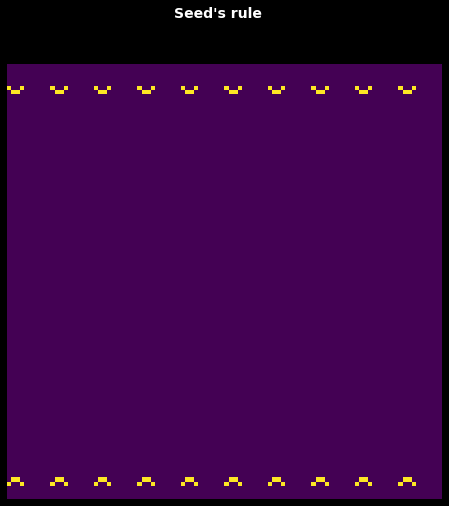

In [146]:
%%capture
seed_ship=np.array([[1,0,0,1],
           [0,1,1,0]])
r_seed_ship=np.array([[0,1,1,0],
           [1,0,0,1]])
grid_1=np.zeros([100,100])
for i in np.arange(0,100, 10):
    grid_1[5:5+seed_ship.shape[0],i:i+seed_ship.shape[1]]=seed_ship
    grid_1[95:95+seed_ship.shape[0],i:i+seed_ship.shape[1]]=r_seed_ship
game_snaps_R=[np.copy(grid_1)]
for i in tqdm(range(500)):
    new_grid=Seed_update(grid_1)
    game_snaps_R.append(np.copy(new_grid))
    grid_1=np.copy(new_grid)
ANIM_SEED_SHIP=generate_anim(game_snaps_R, title="Seed's rule")


In [147]:
ANIM_SEED_SHIP